In [ ]:
import sys
from pathlib import Path

project_root = Path.cwd().parents[0]  # importing functions from other folders
sys.path.insert(0, str(project_root))

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from _data.data_utils import read_in
from _fitting.fitting_utils import hist_plot, CI_plot, CI_plot_alt, CI_plot_both, plot_posteriors_side_by_side, plot_spline
import pymc as pm
import arviz as az
from patsy import dmatrix
import nutpie
import time
from pprint import pprint
from IPython.display import display
import seaborn as sns
from pymc.variational.callbacks import CheckParametersConvergence

az.style.use("arviz-darkgrid")


if '___laptop' in os.listdir('../'):
    # laptop folder
    folder = "../../_data/p-dengue/"
elif '___server' in os.listdir('../'):
    # server folder
    folder = "../../../../../data/lucaratzinger_data/p_dengue/"

In [2]:
data = read_in(folder, admin=2, max_lag=6)
data = data.dropna()
data = data.loc[data['year']<2020, :]

rng = np.random.default_rng(42)
keep_admin2 = rng.choice(
    data["admin2"].unique(),
    size=int(0.5 * data["admin2"].nunique()),
    replace=False
)
#data = data[data["admin2"].isin(keep_admin2)]

---
## NB intercept

In [3]:
model_intercept_nb = pm.Model()
with model_intercept_nb:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)

    # Link
    log_mu = (intercept +
              pm.math.log(data['population']))

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [ ]:
with model_intercept_nb:
    s = time.time()
    idata = pm.sample(tune=1000, draws=2000, chains=4, discard_tuned_samples=True, nuts_sampler="nutpie")
    print(f'Posterior Sampling {time.time() - s:.2f} seconds')

Progress,Draws,Divergences,Step Size,Gradients/Draw
,3000,0,1.24,3
,3000,0,1.30,1
,3000,0,1.19,1
,3000,0,1.08,3


Posterior Sampling 10.12 seconds


In [5]:
model_intercept_nb = pm.Model()
with model_intercept_nb:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)

    # Link
    log_mu = (intercept +
              pm.math.log(data['population']))

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [7]:
with model_intercept_nb:
    # mean_field = pm.fit()
    mean_field = pm.fit(100_000, obj_optimizer=pm.adam(learning_rate=1e-3), method='advi',
        callbacks=[CheckParametersConvergence(diff="relative")])
idata_vi = mean_field.sample(100_000)

Output()

Convergence achieved at 32600
Interrupted at 32,599 [32%]: Average Loss = 1.0972e+05


In [ ]:
plt.plot(mean_field.hist);

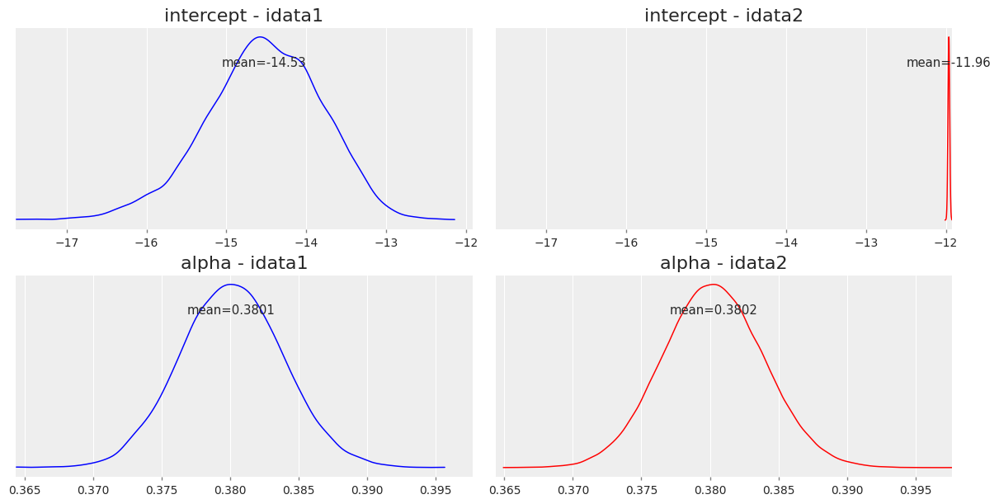

In [46]:
plot_posteriors_side_by_side(idata, idata_vi, var_names=['intercept', 'alpha'])

---
# Spline

In [70]:
model_intercept_nb_sus1 = pm.Model()
with model_intercept_nb_sus1:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)
    beta_u = pm.Normal("beta_u", mu=0, sigma=1)

    # spline
    # degree=3 gives cubic splines
    num_knots1 = 3
    d = data['t2m_mean_pop_weighted (0)']
    knot_list1 = np.percentile(d, np.linspace(0, 100, num_knots1 + 2))[1:-1]
    B1 = dmatrix(
    "bs(s1, knots=knots, degree=3, include_intercept=False)-1",
    {"s1": d, "knots": knot_list1},)
    
    # Spline coefficients
    sigma_w1 = pm.HalfNormal("sigma_w1", sigma=0.5)
    w1 = pm.Normal("w1", mu=0, sigma=1, size=B1.shape[1], dims="splines")
    
    # Spline contribution
    f_s1 = sigma_w1 * pm.math.dot(np.asarray(B1, order="F"), w1)

    # Link
    log_mu = (intercept + pm.math.log(data['population']) +
              pm.math.log(data['urban_surveillance_pop_weighted']+1e-3) +
              beta_u*data['urbanisation_pop_weighted'] +
              f_s1)

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [75]:
model_intercept_nb_sus1 = pm.Model()
with model_intercept_nb_sus1:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)
    beta_u = pm.Normal("beta_u", mu=0, sigma=1)

    # spline
    # degree=3 gives cubic splines
    num_knots1 = 3
    d = data['t2m_mean_pop_weighted (0)']
    knot_list1 = np.linspace(np.min(d), np.max(d), num_knots1+2)[1:-1]
    B1 = dmatrix(
    "bs(s1, knots=knots, degree=3, include_intercept=False)-1",
    {"s1": d, "knots": knot_list1},)
    
    # Spline coefficients
    sigma_w1 = pm.HalfNormal("sigma_w1", sigma=0.5)
    w1 = pm.Normal("w1", mu=0, sigma=1, size=B1.shape[1], dims="splines")
    
    # Spline contribution
    f_s1 = sigma_w1 * pm.math.dot(np.asarray(B1, order="F"), w1)

    # Link
    log_mu = (intercept + pm.math.log(data['population']) +
              pm.math.log(data['urban_surveillance_pop_weighted']+1e-3) +
              beta_u*data['urbanisation_pop_weighted'] +
              f_s1)

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [77]:
with model_intercept_nb_sus1:
    s = time.time()
    idata = pm.sample(tune=1000, draws=2000, chains=4, discard_tuned_samples=True, nuts_sampler="nutpie")
    print(f'Posterior Sampling {time.time() - s:.2f} seconds')

Progress,Draws,Divergences,Step Size,Gradients/Draw
,3000,1,0.12,127
,3000,0,0.13,31
,3000,0,0.13,255
,3000,1,0.11,31


Posterior Sampling 340.78 seconds


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
intercept,-11.767,0.661,-13.041,-10.546,0.021,0.014,1035.0,1176.0,1.0
alpha,0.381,0.004,0.374,0.388,0.000,0.000,9487.0,5258.0,1.0
beta_u,-0.430,0.035,-0.496,-0.366,0.000,0.000,7535.0,5263.0,1.0
sigma_w1,1.923,0.274,1.427,2.446,0.007,0.005,1562.0,2016.0,1.0
w1[0],-3.022,0.734,-4.396,-1.654,0.012,0.008,3752.0,5320.0,1.0
w1[1],-1.522,0.449,-2.397,-0.708,0.010,0.007,1831.0,2392.0,1.0
w1[2],1.641,0.433,0.829,2.453,0.014,0.008,1006.0,1393.0,1.0
w1[3],0.976,0.376,0.248,1.653,0.012,0.007,997.0,1322.0,1.0
w1[4],1.645,0.428,0.802,2.405,0.014,0.009,995.0,1339.0,1.0
w1[5],-0.834,0.371,-1.567,-0.188,0.010,0.007,1373.0,1969.0,1.0


array([[<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'intercept'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'alpha'}>],
       [<Axes: title={'center': 'beta_u'}>,
        <Axes: title={'center': 'beta_u'}>],
       [<Axes: title={'center': 'sigma_w1'}>,
        <Axes: title={'center': 'sigma_w1'}>],
       [<Axes: title={'center': 'w1'}>, <Axes: title={'center': 'w1'}>]],
      dtype=object)

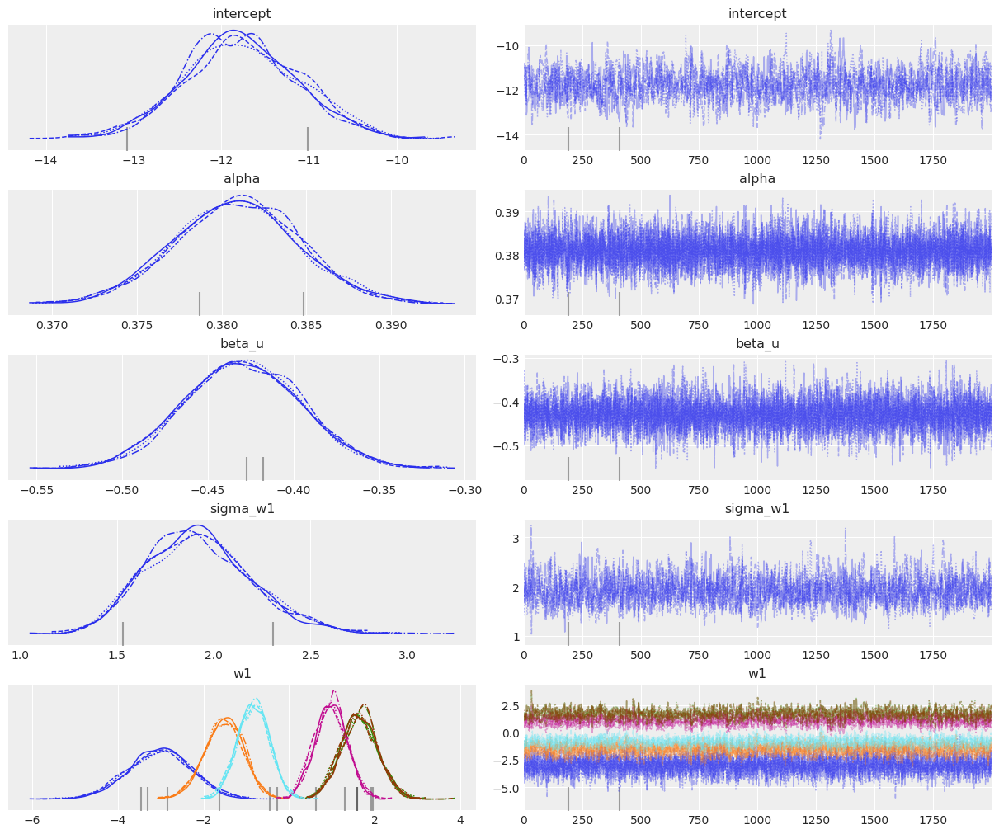

In [82]:
var_names = ['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1']
display(az.summary(idata, var_names=var_names))
az.plot_trace(idata, var_names=var_names)

In [53]:
model_intercept_nb_sus1 = pm.Model()
with model_intercept_nb_sus1:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)
    beta_u = pm.Normal("beta_u", mu=0, sigma=1)

    # spline
    # degree=3 gives cubic splines
    num_knots1 = 3
    d = data['t2m_mean_pop_weighted (0)']
    knot_list1 = np.percentile(d, np.linspace(0, 100, num_knots1 + 2))[1:-1]
    B1 = dmatrix(
    "bs(s1, knots=knots, degree=3, include_intercept=False)-1",
    {"s1": d, "knots": knot_list1},)
    
    # Spline coefficients
    sigma_w1 = pm.HalfNormal("sigma_w1", sigma=0.5)
    w1 = pm.Normal("w1", mu=0, sigma=1, size=B1.shape[1], dims="splines")
    
    # Spline contribution
    f_s1 = sigma_w1 * pm.math.dot(np.asarray(B1, order="F"), w1)

    # Link
    log_mu = (intercept + pm.math.log(data['population']) +
              pm.math.log(data['urban_surveillance_pop_weighted']+1e-3) +
              beta_u*data['urbanisation_pop_weighted'] +
              f_s1)

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [58]:
with model_intercept_nb_sus1:
    # mean_field = pm.fit()
    mean_field = pm.fit(100_000, obj_optimizer=pm.adam(learning_rate=1e-3), method='fullrank_advi',
        callbacks=[CheckParametersConvergence(diff="relative")])
idata_vi = mean_field.sample(100_000)

Output()

Finished [100%]: Average Loss = 83,479


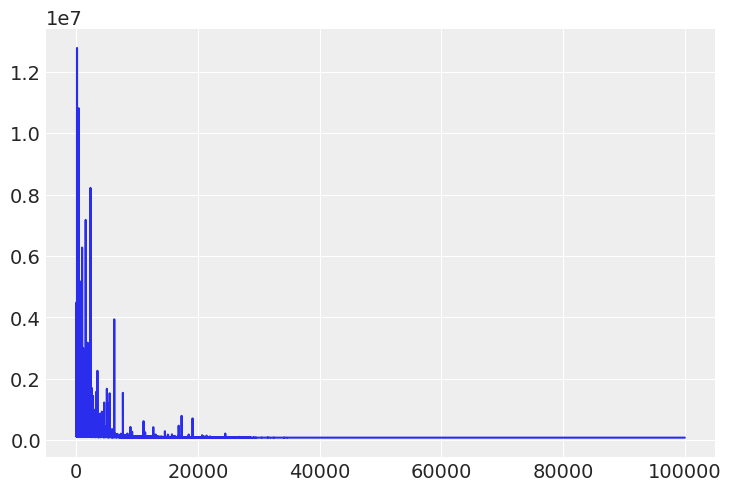

In [59]:
plt.plot(mean_field.hist);

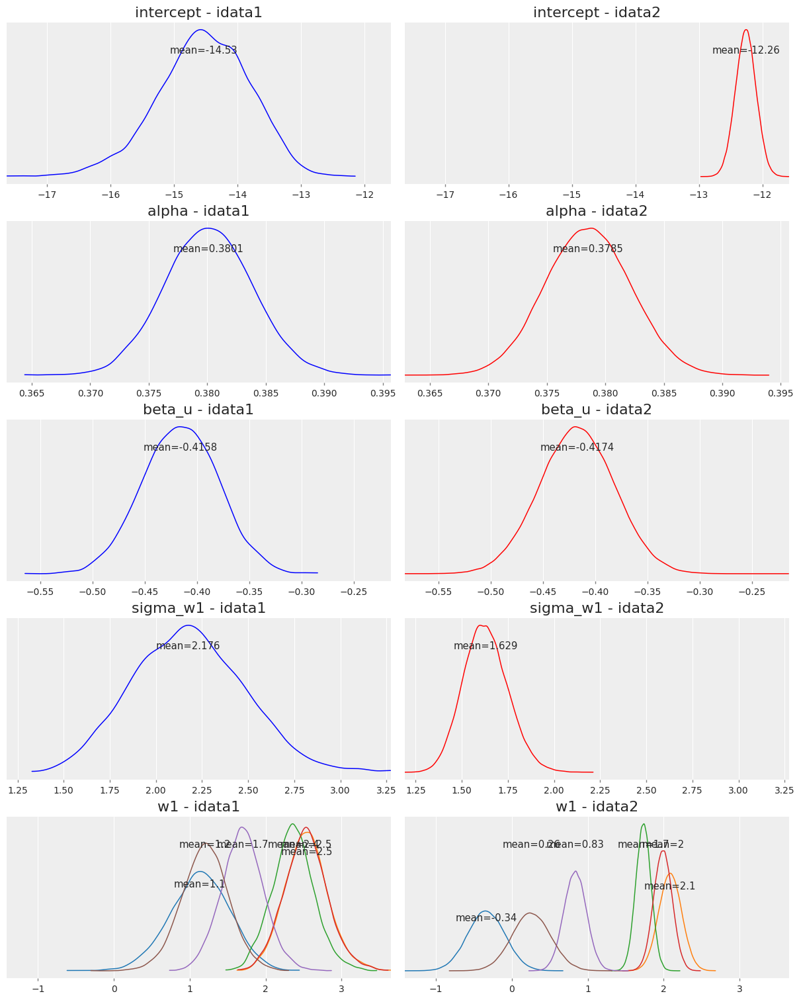

In [60]:
plot_posteriors_side_by_side(idata, idata_vi, var_names=['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1'])

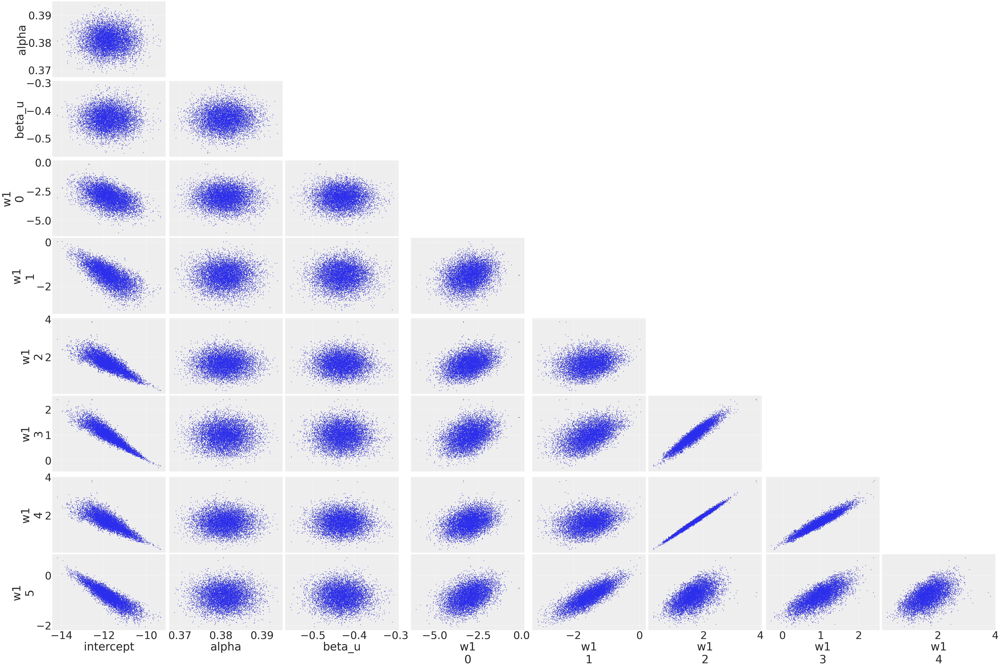

In [ ]:
az.plot_pair(idata, var_names=['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1'], textsize=50);

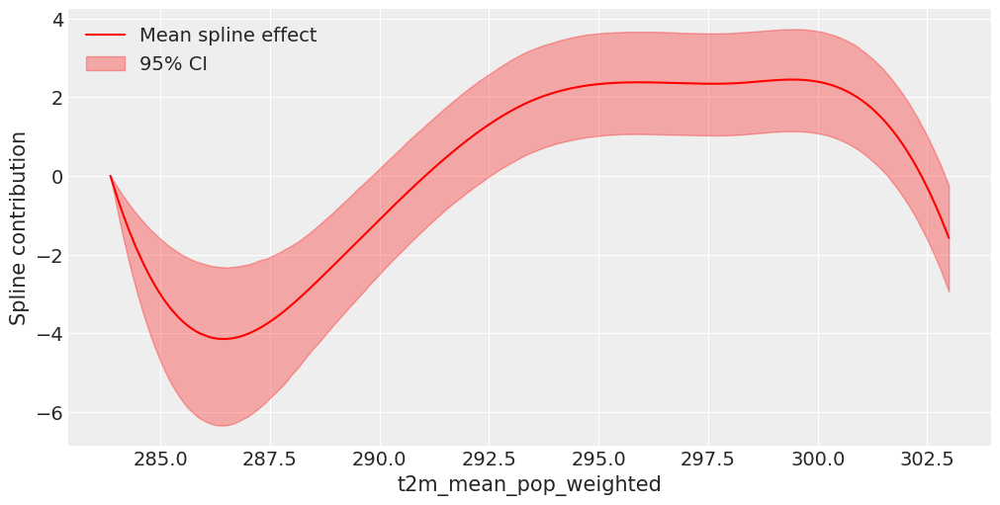

In [ ]:
plot_spline(idata, 'w1', 'sigma_w1', B1, data['t2m_mean_pop_weighted (0)'])


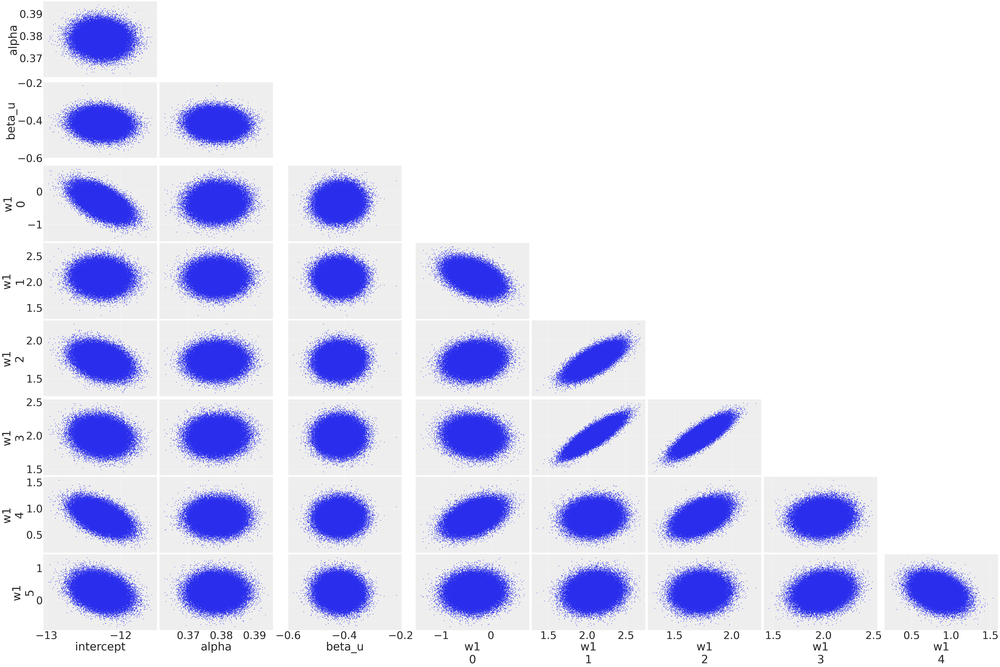

In [ ]:
az.plot_pair(idata_vi, var_names=['intercept', 'alpha', 'beta_u', 'sigma_w1','w1'], textsize=50);

---

In [83]:
model_intercept_nb_sus1 = pm.Model()
with model_intercept_nb_sus1:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)
    beta_u = pm.Normal("beta_u", mu=0, sigma=1)

    # spline
    # degree=3 gives cubic splines
    num_knots1 = 3
    d = data['t2m_mean_pop_weighted (0)']
    knot_list1 = np.linspace(np.min(d), np.max(d), num_knots1+2)[1:-1]
    knot_list1 = np.percentile(d, np.linspace(0, 100, num_knots1 + 2))[1:-1]
    B1 = dmatrix(
    "bs(s1, knots=knots, degree=2, include_intercept=False)-1",
    {"s1": d, "knots": knot_list1},)
    
    # Spline coefficients
    sigma_w1 = pm.HalfNormal("sigma_w1", sigma=0.5)
    w1 = pm.Normal("w1", mu=0, sigma=1, size=B1.shape[1], dims="splines")
    
    # Spline contribution
    f_s1 = sigma_w1 * pm.math.dot(np.asarray(B1, order="F"), w1)

    # Link
    log_mu = (intercept + pm.math.log(data['population']) +
              pm.math.log(data['urban_surveillance_pop_weighted']+1e-3) +
              beta_u*data['urbanisation_pop_weighted'] +
              f_s1)

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [84]:
with model_intercept_nb_sus1:
    s = time.time()
    idata2 = pm.sample(tune=1000, draws=2000, chains=4, discard_tuned_samples=True, nuts_sampler="nutpie")
    print(f'Posterior Sampling {time.time() - s:.2f} seconds')

Progress,Draws,Divergences,Step Size,Gradients/Draw
,3000,0,0.10,63
,3000,0,0.12,159
,3000,0,0.11,175
,3000,0,0.11,27


Posterior Sampling 452.73 seconds


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
intercept,-16.867,0.606,-17.952,-15.707,0.015,0.011,1748.0,1777.0,1.00
alpha,0.381,0.004,0.374,0.388,0.000,0.000,7507.0,5165.0,1.00
beta_u,-0.412,0.036,-0.482,-0.346,0.000,0.000,5512.0,4258.0,1.00
sigma_w1,2.737,0.273,2.181,3.215,0.007,0.005,1561.0,2126.0,1.01
w1[0],2.942,0.288,2.446,3.493,0.007,0.005,1521.0,2188.0,1.00
w1[1],2.701,0.253,2.251,3.173,0.007,0.004,1500.0,2055.0,1.01
w1[2],2.826,0.263,2.348,3.305,0.007,0.004,1487.0,2139.0,1.01
w1[3],2.598,0.250,2.144,3.055,0.006,0.004,1531.0,2248.0,1.01
w1[4],1.827,0.232,1.416,2.283,0.005,0.003,1843.0,2928.0,1.00


array([[<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'intercept'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'alpha'}>],
       [<Axes: title={'center': 'beta_u'}>,
        <Axes: title={'center': 'beta_u'}>],
       [<Axes: title={'center': 'sigma_w1'}>,
        <Axes: title={'center': 'sigma_w1'}>],
       [<Axes: title={'center': 'w1'}>, <Axes: title={'center': 'w1'}>]],
      dtype=object)

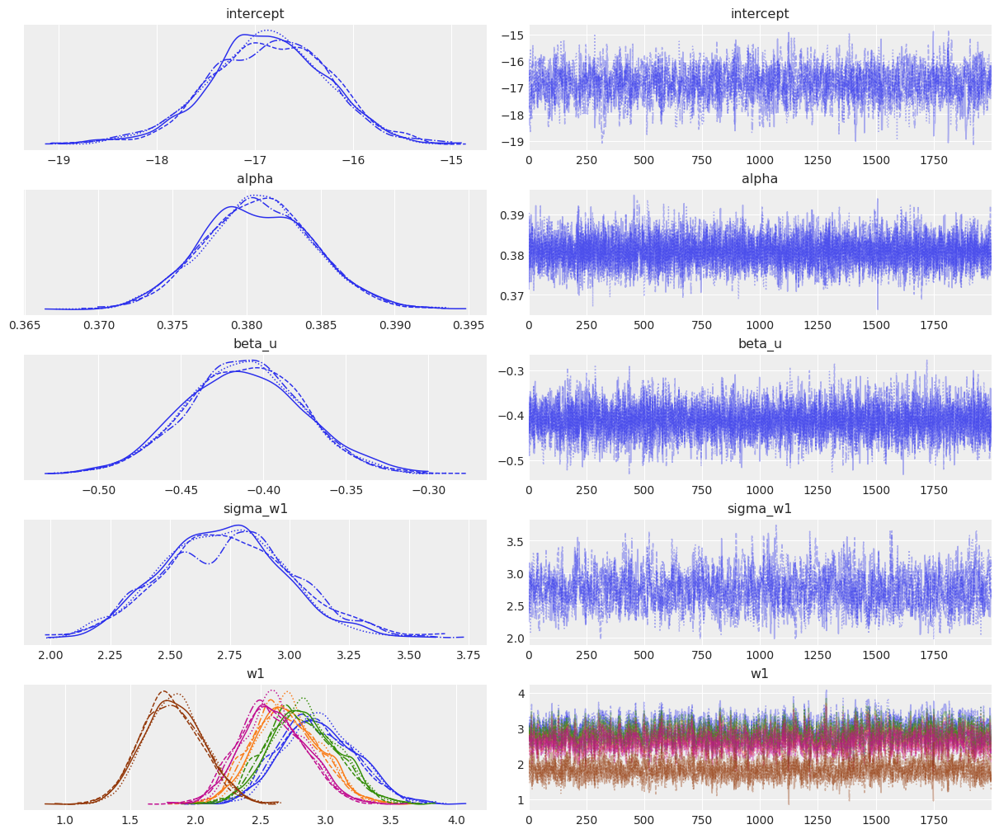

In [86]:
var_names = ['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1']
display(az.summary(idata2, var_names=var_names))
az.plot_trace(idata2, var_names=var_names)

In [140]:
plot_spline(idata2, 'w1', 'sigma_w1', B1, data['t2m_mean_pop_weighted (0)'])


ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 5 is different from 6)

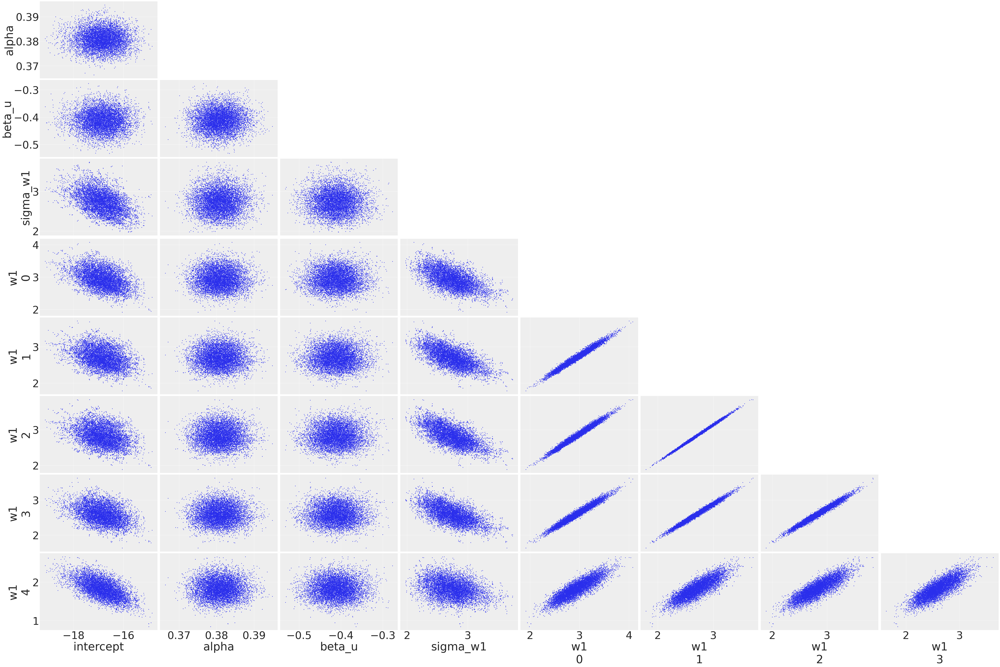

In [93]:
az.plot_pair(idata2, var_names=['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1'], textsize=50);

---

In [97]:
model_intercept_nb_sus1 = pm.Model()
with model_intercept_nb_sus1:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)
    beta_u = pm.Normal("beta_u", mu=0, sigma=1)

    # spline
    # degree=3 gives cubic splines
    num_knots1 = 3
    d = data['t2m_mean_pop_weighted (0)']
    knot_list1 = np.linspace(np.min(d), np.max(d), num_knots1+2)[1:-1]
    knot_list1 = np.percentile(d, np.linspace(0, 100, num_knots1 + 2))[1:-1]
    B1 = dmatrix(
    "bs(s1, knots=knots, degree=3, include_intercept=False)-1",
    {"s1": d, "knots": knot_list1},)
    
    # Spline coefficients
    sigma_w1 = pm.HalfNormal("sigma_w1", sigma=0.5)
    w1 = pm.Normal("w1", mu=0, sigma=1, size=B1.shape[1], dims="splines")
    
    # Spline contribution
    f_s1_raw = pm.math.dot(B1, w1)
    f_s1 = sigma_w1 * (f_s1_raw - pm.math.mean(f_s1_raw))
    # f_s1 = sigma_w1 * pm.math.dot(np.asarray(B1, order="F"), w1)

    # Link
    log_mu = (intercept + pm.math.log(data['population']) +
              pm.math.log(data['urban_surveillance_pop_weighted']+1e-3) +
              beta_u*data['urbanisation_pop_weighted'] +
              f_s1)

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [98]:
with model_intercept_nb_sus1:
    s = time.time()
    idata3 = pm.sample(tune=1000, draws=2000, chains=4, discard_tuned_samples=True, nuts_sampler="nutpie")
    print(f'Posterior Sampling {time.time() - s:.2f} seconds')

Progress,Draws,Divergences,Step Size,Gradients/Draw
,3000,0,0.22,23
,3000,0,0.27,15
,3000,0,0.23,31
,3000,0,0.25,31


Posterior Sampling 131.99 seconds


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
intercept,-9.490,0.023,-9.535,-9.448,0.000,0.000,5214.0,4777.0,1.0
alpha,0.380,0.004,0.373,0.387,0.000,0.000,9694.0,5231.0,1.0
beta_u,-0.418,0.036,-0.486,-0.350,0.001,0.000,5260.0,4822.0,1.0
sigma_w1,2.696,0.351,2.022,3.341,0.006,0.004,3992.0,4065.0,1.0
w1[0],1.903,0.434,1.103,2.730,0.011,0.008,1565.0,2013.0,1.0
w1[1],2.755,0.294,2.212,3.312,0.008,0.006,1306.0,1544.0,1.0
w1[2],2.669,0.302,2.092,3.225,0.009,0.006,1263.0,1438.0,1.0
w1[3],2.791,0.302,2.215,3.351,0.009,0.006,1268.0,1492.0,1.0
w1[4],2.139,0.316,1.549,2.726,0.009,0.006,1381.0,1639.0,1.0
w1[5],1.709,0.335,1.082,2.328,0.008,0.005,1590.0,2448.0,1.0


array([[<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'intercept'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'alpha'}>],
       [<Axes: title={'center': 'beta_u'}>,
        <Axes: title={'center': 'beta_u'}>],
       [<Axes: title={'center': 'sigma_w1'}>,
        <Axes: title={'center': 'sigma_w1'}>],
       [<Axes: title={'center': 'w1'}>, <Axes: title={'center': 'w1'}>]],
      dtype=object)

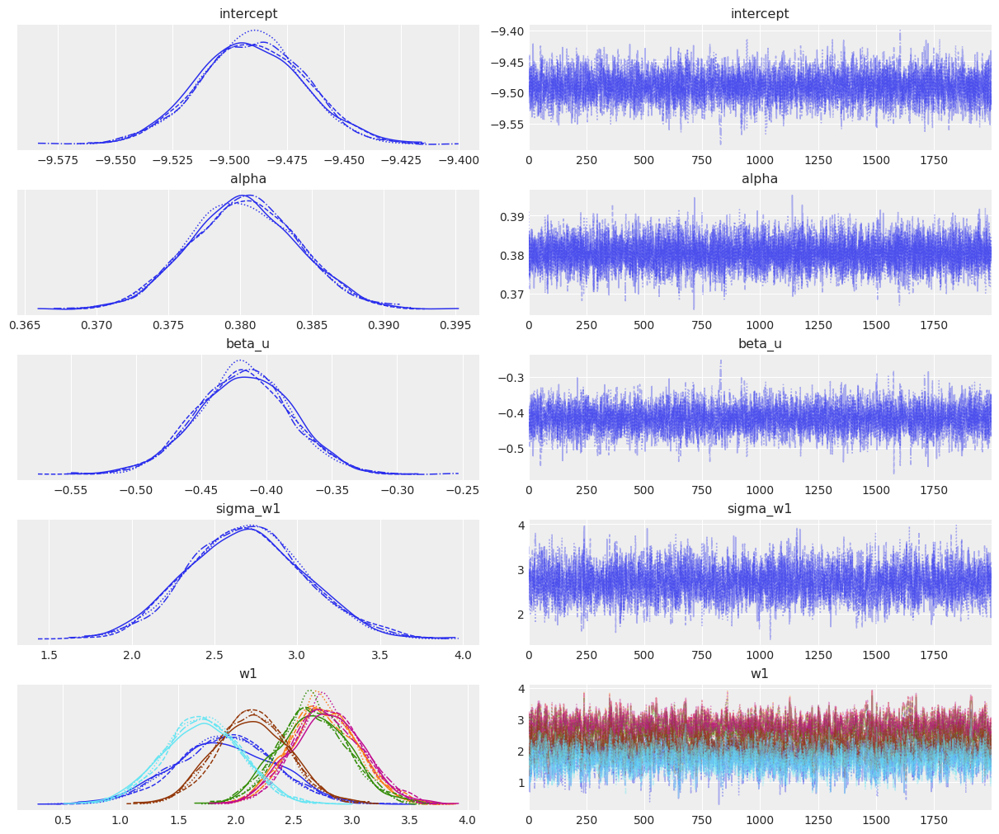

In [99]:
var_names = ['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1']
display(az.summary(idata3, var_names=var_names))
az.plot_trace(idata3, var_names=var_names)

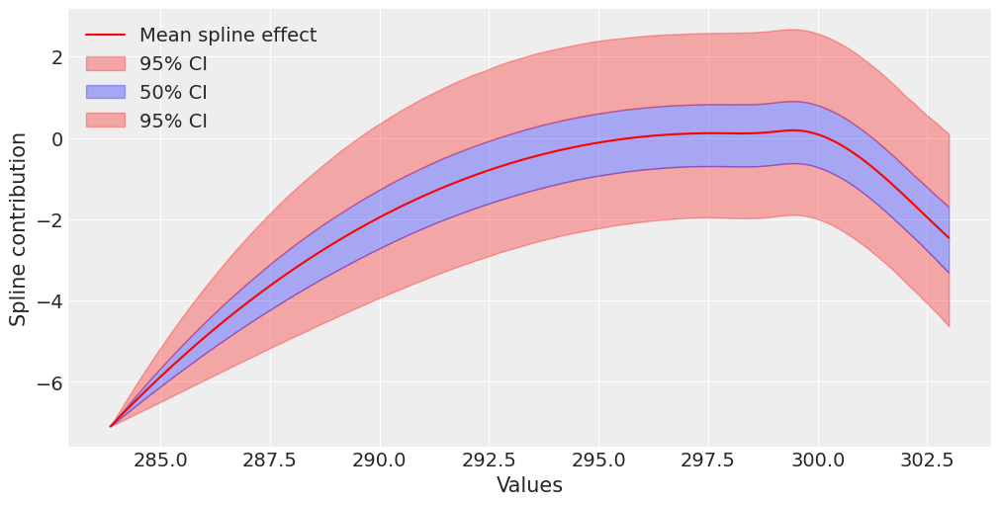

In [139]:
plot_spline(idata3, 'w1', 'sigma_w1', B1, data['t2m_mean_pop_weighted (0)'])


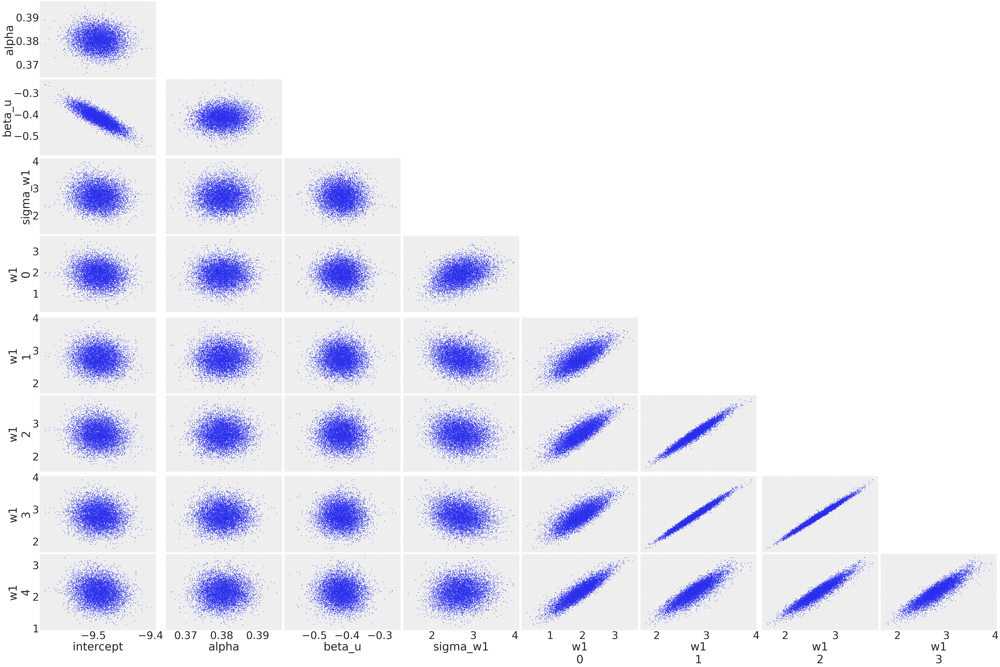

In [102]:
az.plot_pair(idata3, var_names=['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1'], textsize=50);

---

In [122]:
model_intercept_nb_sus1 = pm.Model()
with model_intercept_nb_sus1:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)
    beta_u = pm.Normal("beta_u", mu=0, sigma=1)

    # spline
    # degree=3 gives cubic splines
    num_knots1 = 3
    d = data['t2m_mean_pop_weighted (0)']
    knot_list1 = np.linspace(np.min(d), np.max(d), num_knots1+2)[1:-1]
    knot_list1 = np.percentile(d, np.linspace(0, 100, num_knots1 + 2))[1:-1]
    B1 = dmatrix(
    "bs(s1, knots=knots, degree=3, include_intercept=False)-1",
    {"s1": d, "knots": knot_list1},)
    
    # Spline coefficients
    sigma_w1 = pm.HalfNormal("sigma_w1", sigma=0.5)
    w1 = pm.Normal("w1", mu=0, sigma=1, size=B1.shape[1], dims="splines")
    
    # Spline contribution
    f_s1_raw = sigma_w1 * pm.math.dot(B1, w1)
    f_s1_mean = pm.Deterministic("f_s1_mean", pm.math.mean(f_s1_raw))
    pm.Potential(
    "f_s1_mean_prior",
    pm.logp(pm.Normal.dist(mu=0.0, sigma=0.01), f_s1_mean))
    f_s1 = f_s1_raw

    # Link
    log_mu = (intercept + pm.math.log(data['population']) +
              pm.math.log(data['urban_surveillance_pop_weighted']+1e-3) +
              beta_u*data['urbanisation_pop_weighted'] +
              f_s1)

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

In [123]:
with model_intercept_nb_sus1:
    s = time.time()
    idata4 = pm.sample(tune=1000, draws=2000, chains=4, discard_tuned_samples=True, nuts_sampler="nutpie")
    print(f'Posterior Sampling {time.time() - s:.2f} seconds')

Progress,Draws,Divergences,Step Size,Gradients/Draw
,3000,0,0.35,31
,3000,0,0.42,15
,3000,0,0.42,15
,3000,0,0.36,15


Posterior Sampling 88.57 seconds


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
intercept,-9.475,0.022,-9.518,-9.434,0.000,0.000,4841.0,5519.0,1.0
alpha,0.379,0.004,0.372,0.385,0.000,0.000,10724.0,5100.0,1.0
beta_u,-0.402,0.035,-0.469,-0.337,0.001,0.000,4792.0,5621.0,1.0
sigma_w1,1.452,0.226,1.058,1.892,0.006,0.004,1675.0,2335.0,1.0
w1[0],-3.027,0.472,-3.915,-2.164,0.012,0.007,1613.0,2169.0,1.0
w1[1],0.573,0.118,0.359,0.802,0.003,0.002,1918.0,3164.0,1.0
w1[2],0.006,0.019,-0.029,0.044,0.000,0.000,3246.0,3791.0,1.0
w1[3],0.341,0.074,0.215,0.491,0.002,0.001,1699.0,2593.0,1.0
w1[4],-1.083,0.226,-1.527,-0.696,0.005,0.003,1841.0,3043.0,1.0
w1[5],-1.493,0.353,-2.143,-0.839,0.005,0.004,4514.0,5298.0,1.0


array([[<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'intercept'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'alpha'}>],
       [<Axes: title={'center': 'beta_u'}>,
        <Axes: title={'center': 'beta_u'}>],
       [<Axes: title={'center': 'sigma_w1'}>,
        <Axes: title={'center': 'sigma_w1'}>],
       [<Axes: title={'center': 'w1'}>, <Axes: title={'center': 'w1'}>]],
      dtype=object)

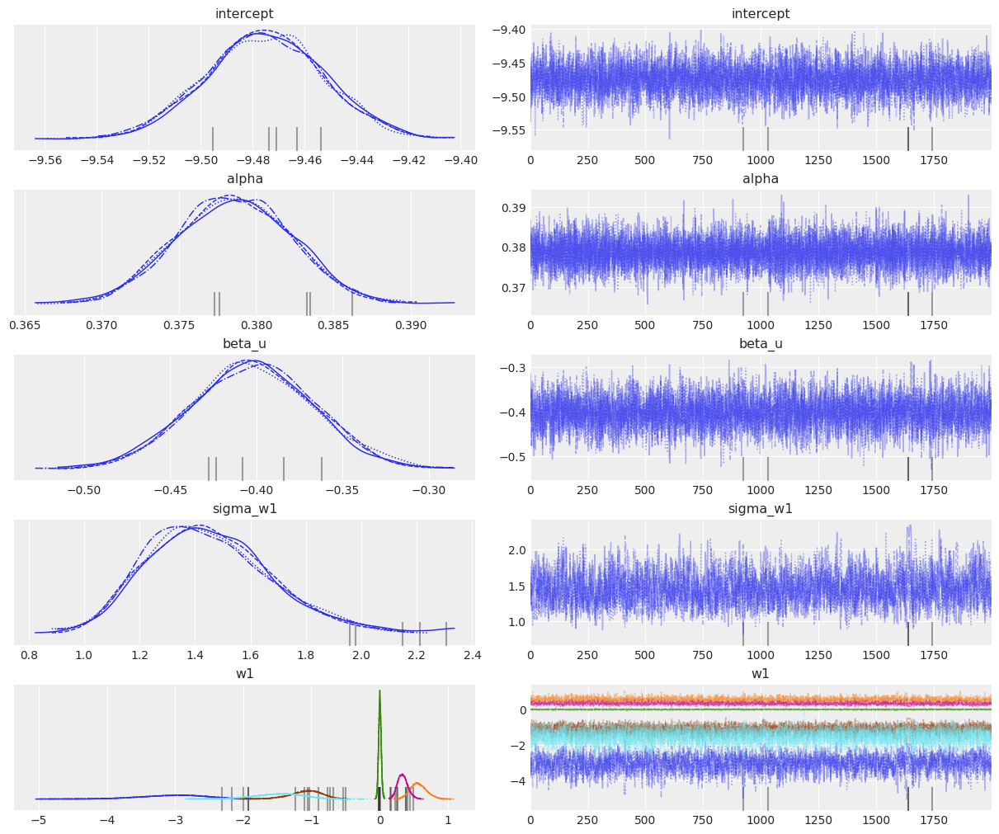

In [ ]:
# 0.005
var_names = ['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1']
display(az.summary(idata4, var_names=var_names))
az.plot_trace(idata4, var_names=var_names)

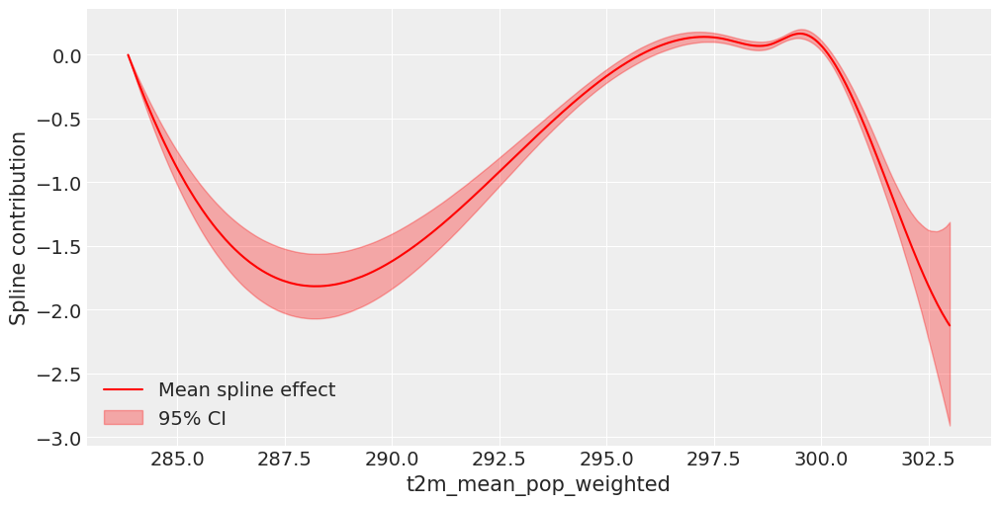

In [ ]:
# 0.005
plot_spline(idata4, 'w1', 'sigma_w1', B1, data['t2m_mean_pop_weighted (0)'])

/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/plots/backends/matplotlib/pairplot.py:223: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


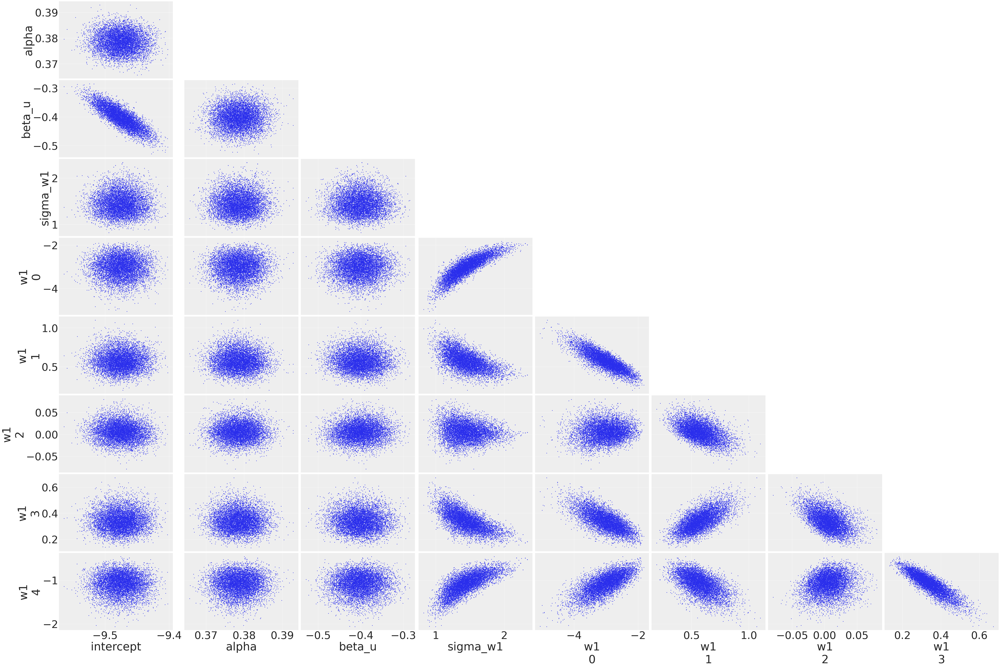

In [ ]:
# 0.005
az.plot_pair(idata4, var_names=['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1'], textsize=50);

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
intercept,-9.477,0.024,-9.522,-9.432,0.000,0.000,5807.0,5135.0,1.0
alpha,0.379,0.004,0.372,0.385,0.000,0.000,10200.0,5657.0,1.0
beta_u,-0.403,0.036,-0.471,-0.337,0.000,0.000,5996.0,5476.0,1.0
sigma_w1,1.454,0.228,1.048,1.891,0.005,0.003,2241.0,3189.0,1.0
w1[0],-3.026,0.480,-3.912,-2.142,0.010,0.007,2164.0,3338.0,1.0
w1[1],0.575,0.119,0.358,0.796,0.002,0.001,2668.0,3977.0,1.0
w1[2],0.007,0.020,-0.030,0.046,0.000,0.000,5381.0,4651.0,1.0
w1[3],0.341,0.074,0.213,0.486,0.002,0.001,2457.0,3737.0,1.0
w1[4],-1.076,0.226,-1.526,-0.692,0.005,0.003,2539.0,3531.0,1.0
w1[5],-1.498,0.361,-2.238,-0.867,0.005,0.004,5128.0,4771.0,1.0


array([[<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'intercept'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'alpha'}>],
       [<Axes: title={'center': 'beta_u'}>,
        <Axes: title={'center': 'beta_u'}>],
       [<Axes: title={'center': 'sigma_w1'}>,
        <Axes: title={'center': 'sigma_w1'}>],
       [<Axes: title={'center': 'w1'}>, <Axes: title={'center': 'w1'}>]],
      dtype=object)

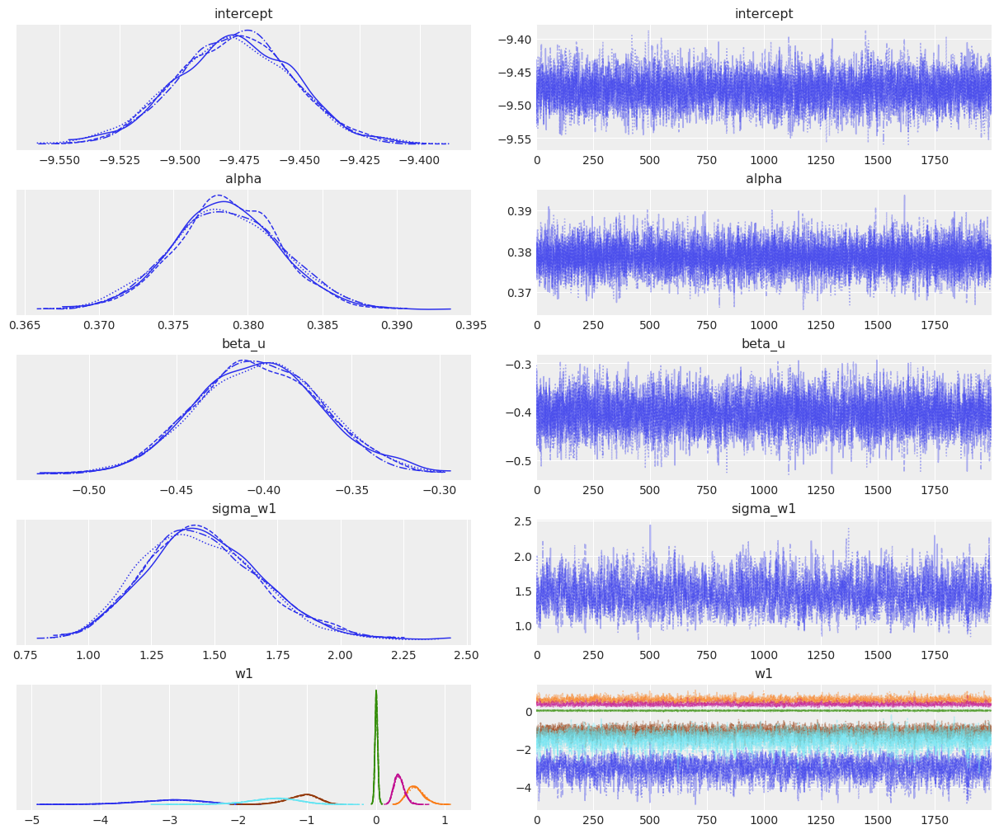

In [124]:
# 0.01
var_names = ['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1']
display(az.summary(idata4, var_names=var_names))
az.plot_trace(idata4, var_names=var_names)

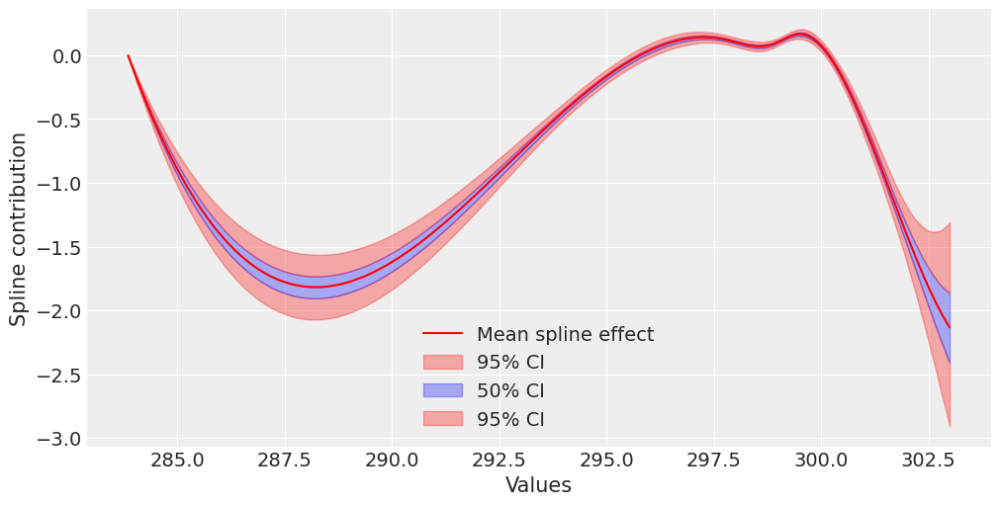

In [ ]:
# 0.01
plot_spline(idata4, 'w1', 'sigma_w1', B1, data['t2m_mean_pop_weighted (0)'])

/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/plots/backends/matplotlib/pairplot.py:223: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


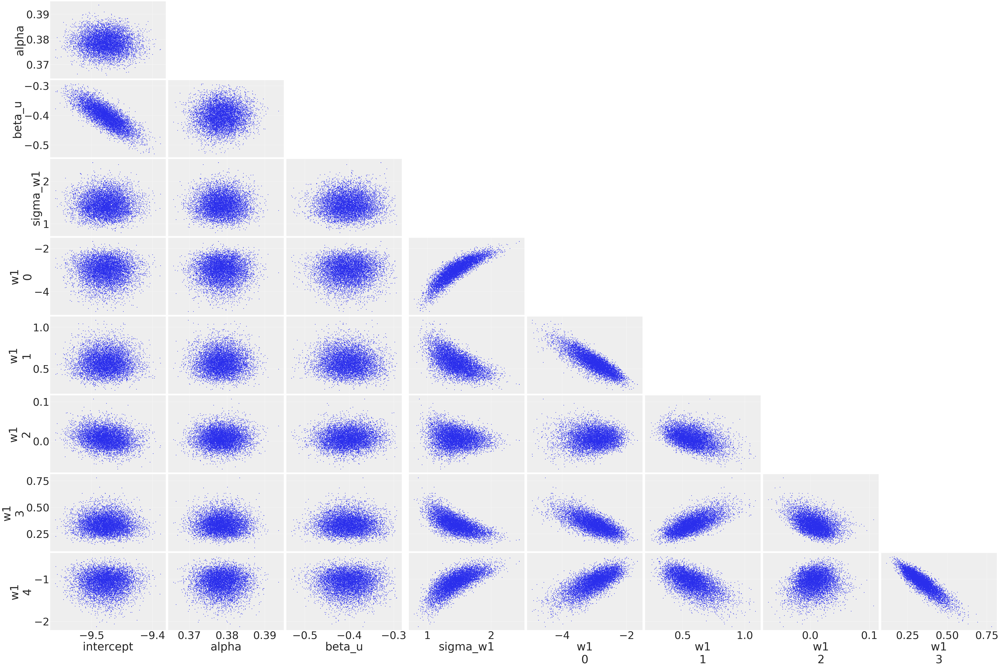

In [126]:
# 0.01
az.plot_pair(idata4, var_names=['intercept', 'alpha', 'beta_u', 'sigma_w1', 'w1'], textsize=50);

---

In [132]:
model_intercept_nb_sus1 = pm.Model()
with model_intercept_nb_sus1:
    # Priors
    alpha = pm.Exponential("alpha", 0.5)
    intercept = pm.Normal("intercept", mu=0, sigma=2.5)
    beta_u = pm.Normal("beta_u", mu=0, sigma=1)

    # spline
    # degree=3 gives cubic splines
    num_knots1 = 3
    d = data['t2m_mean_pop_weighted (0)']
    knot_list1 = np.linspace(np.min(d), np.max(d), num_knots1+2)[1:-1]
    knot_list1 = np.percentile(d, np.linspace(0, 100, num_knots1 + 2))[1:-1]
    B1 = dmatrix(
    "bs(s1, knots=knots, degree=3, include_intercept=False)-1",
    {"s1": d, "knots": knot_list1},)
    
    # Spline coefficients
    sigma_w1 = pm.HalfNormal("sigma_w1", sigma=0.5)
    w1 = pm.Normal("w1", mu=0, sigma=1, size=B1.shape[1], dims="splines")
    
    # Spline contribution
    f_s1_raw = pm.math.dot(B1, w1)
    f_s1_mean = pm.math.mean(f_s1_raw)
    f_s1_var  = pm.math.mean((f_s1_raw - f_s1_mean) ** 2)
    f_s1_std = pm.math.sqrt(f_s1_var + 1e-6)

    pm.Potential(
    "f_s1_centred_prior",
    pm.logp(pm.Normal.dist(mu=0.0, sigma=0.01), f_s1_mean/(f_s1_std+1e-6)))
    f_s1 = sigma_w1*f_s1_raw

    # Link
    u_d = data['urbanisation_pop_weighted']
    u_d_mean = pm.math.mean(u_d)
    u_d_var = pm.math.mean(u_d**2)
    u_d_std = pm.math.sqrt(u_d_var+1e-6)
    log_mu = (intercept + pm.math.log(data['population']) +
              pm.math.log(data['urban_surveillance_pop_weighted']+1e-3) +
              beta_u*((u_d - u_d_mean)/u_d_std) +
              f_s1)

    # Likelihood
    y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

ValueError: setting an array element with a sequence.